# Pandas

This notebook covers a _lot_, go through it carefully and _read_ the code. Then work on _understanding_ it. Then apply it to your data set. Then once you've done that, you'll probably _actually_ understand it.

Messing about with the [NSW Penalty data](http://www.osr.nsw.gov.au/sites/default/files/file_manager/penalty_data_set_0.csv)

`imports`, you've seen this before!

In [43]:
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import geopandas as gp
import fiona
import os
from datetime import datetime
import geopy
from geopy.geocoders import Nominatim
import shapely
import folium
from folium import Marker

shp_file_name = "NSW_LOC_POLYGON_shp/NSW_LOC_POLYGON_shp.shp"
zip_file_name = "nsw_loc_polygon_shp.zip"
web_file_path = (
    "https://data.gov.au/data/dataset/"
    "91e70237-d9d1-4719-a82f-e71b811154c6/resource/"
    "5e295412-357c-49a2-98d5-6caf099c2339/download/"
    "nsw_locality_polygon_shp.zip")

new_fuel_station_coordinates = pd.read_csv("price_history_checks_may2021.csv")
fuel_stations = pd.read_excel("price_history_checks_may2021.xlsx")
fuel_depots = pd.read_csv("LiquidFuelDepots_v1.csv")
fuel_station_coordinates = pd.read_csv("stations_lat_long.csv")
print("done")


done


In [3]:
%matplotlib inline
plt.rcParams['figure.figsize'] = (30, 25)


In [4]:
# give us a style state to go back to
saved_style_state = matplotlib.rcParams.copy()


In [5]:
def unzip_zipfile(zipped_file_path, put_it_here="."):
    import zipfile
    zip_of_suburbs = zipfile.ZipFile(zipped_file_path, 'r')
    zip_of_suburbs.extractall(put_it_here)
    zip_of_suburbs.close()


In [6]:
if os.path.isfile(shp_file_name):
    print("loading from file")
else:
    if os.path.isfile(zip_file_name):
        print("unzipping")
        unzip_zipfile(zip_file_name)
    else:
        import requests
        print("loading from the internet")
        page = requests.get(web_file_path)
        with open(zip_file_name, 'wb') as z:
            z.write(page.content)
        unzip_zipfile(zip_file_name)

print("done")


loading from file
done


In [7]:
burbs = gp.GeoDataFrame.from_file(shp_file_name)
burbs.set_crs(epsg=5234, inplace=True, allow_override=True)
# https://epsg.io/8021
# GDA2020 is the latest and least wrong coord set for Sydney
burbs.sample(2)


,LC_PLY_PID,DT_CREATE,DT_RETIRE,LOC_PID,NSW_LOCALI,NSW_LOCA_1,NSW_LOCA_2,NSW_LOCA_3,NSW_LOCA_4,NSW_LOCA_5,NSW_LOCA_6,NSW_LOCA_7,geometry
4188,37548,2021-02-09,None,NSW5122,2018-11-07,None,BURRUNGUBUGGE,None,None,G,None,1,"POLYGON ((148.43072 -36.17535, 148.43130 -36.1..."
4112,37460,2021-02-09,None,NSW1241,2013-01-23,None,DEEP CREEK,None,2440,G,None,1,"POLYGON ((152.70577 -30.93261, 152.70576 -30.9..."


In [8]:
# def get_merge_geometry(row):
#     lati = fuel_station_coordinates.latitude
#     longi = fuel_station_coordinates.longitude
#     try:
#         for points in lati, longi:
#             if row[points]:
#                 return row[points]
#     except Exception as e:
#         return lati, longi


In [9]:
def dateparser(x): return pd.to_datetime(x, dayfirst=True)


price_df = pd.read_excel(
    "price_history_checks_may2021.xlsx", parse_dates=["PriceUpdatedDate"], date_parser=dateparser
)

price_df.head()


,ServiceStationName,Address,Suburb,Postcode,Brand,FuelCode,PriceUpdatedDate,Price
0,Metro Fuel Killarney Heights,"702-704 Warringah Road, Forestville NSW 2087",Forestville,2087.0,Metro Fuel,U91,2021-05-01 00:01:20,137.9
1,NaN,NaN,NaN,NaN,NaN,E10,2021-05-01 00:01:20,135.9
2,NaN,NaN,NaN,NaN,NaN,P98,2021-05-01 00:01:20,155.9
3,Caltex Cambridge,"Lot 6 Star Court, CAMBRIDGE PARK NSW 2747",CAMBRIDGE PARK,2747.0,Caltex,P95,2021-05-01 00:06:09,152.9
4,Westside Adamstown,"125 Brunker Rd, Adamstown NSW 2289",Adamstown,2289.0,Westside,DL,2021-05-01 00:07:01,136.9


In [10]:
fuel_codes = price_df.FuelCode.unique()
fuel_codes = [x for x in fuel_codes if type(x) is str]
print(fuel_codes)

new_column_names = (
    [f"Price_{name}_UpdatedDate" for name in fuel_codes]
    + [f"Price_{name}" for name in fuel_codes]
    + [
        name
        for name in price_df.columns
        if name not in ["FuelCode", "PriceUpdatedDate", "Price"]
    ]
)
new_column_names.sort()
print(new_column_names)
new_rows = []
temp_row = pd.Series(index=new_column_names, dtype=object)

for i, row in price_df.iterrows():
    fc = row.FuelCode
    if row.ServiceStationName is not np.NaN:
        new_rows.append(temp_row)
        temp_row = pd.Series(index=new_column_names, dtype=object)
        for key, element in row.iteritems():
            if key in temp_row.index:
                temp_row[key] = element
        temp_row[f"Price_{fc}_UpdatedDate"] = row.PriceUpdatedDate
        temp_row[f"Price_{fc}"] = row.Price
    elif row.ServiceStationName is np.NaN:
        temp_row[f"Price_{fc}_UpdatedDate"] = row.PriceUpdatedDate
        temp_row[f"Price_{fc}"] = row.Price

reshaped_df = pd.DataFrame(new_rows)
reshaped_df.drop([0], inplace=True)
reshaped_df.head()


['U91', 'E10', 'P98', 'P95', 'DL', 'PDL', 'LPG', 'E85']
['Address', 'Brand', 'Postcode', 'Price_DL', 'Price_DL_UpdatedDate', 'Price_E10', 'Price_E10_UpdatedDate', 'Price_E85', 'Price_E85_UpdatedDate', 'Price_LPG', 'Price_LPG_UpdatedDate', 'Price_P95', 'Price_P95_UpdatedDate', 'Price_P98', 'Price_P98_UpdatedDate', 'Price_PDL', 'Price_PDL_UpdatedDate', 'Price_U91', 'Price_U91_UpdatedDate', 'ServiceStationName', 'Suburb']


,Address,Brand,Postcode,Price_DL,Price_DL_UpdatedDate,Price_E10,Price_E10_UpdatedDate,Price_E85,Price_E85_UpdatedDate,Price_LPG,...,Price_P98,Price_P98_UpdatedDate,Price_PDL,Price_PDL_UpdatedDate,Price_U91,Price_U91_UpdatedDate,ServiceStationName,Suburb,Price_nan_UpdatedDate,Price_nan
1,"702-704 Warringah Road, Forestville NSW 2087",Metro Fuel,2087.0,NaN,NaT,135.9,2021-05-01 00:01:20,NaN,NaT,NaN,...,155.9,2021-05-01 00:01:20,NaN,NaT,137.9,2021-05-01 00:01:20,Metro Fuel Killarney Heights,Forestville,NaT,NaN
2,"Lot 6 Star Court, CAMBRIDGE PARK NSW 2747",Caltex,2747.0,NaN,NaT,NaN,NaT,NaN,NaT,NaN,...,NaN,NaT,NaN,NaT,NaN,NaT,Caltex Cambridge,CAMBRIDGE PARK,NaT,NaN
3,"125 Brunker Rd, Adamstown NSW 2289",Westside,2289.0,136.9,2021-05-01 00:07:01,NaN,NaT,NaN,NaT,NaN,...,158.9,2021-05-01 00:07:01,NaN,NaT,NaN,NaT,Westside Adamstown,Adamstown,NaT,NaN
4,"323 River Street, BALLINA NSW 2478",Metro Fuel,2478.0,NaN,NaT,139.9,2021-05-01 00:14:40,NaN,NaT,NaN,...,161.9,2021-05-01 00:14:40,137.9,2021-05-01 00:14:40,142.9,2021-05-01 00:14:40,Metro Petroleum Ballina,BALLINA,NaT,NaN
5,"656 Warringah Road, FORESTVILLE NSW 2087",Metro Fuel,2087.0,NaN,NaT,135.9,2021-05-01 00:15:42,NaN,NaT,NaN,...,NaN,NaT,NaN,NaT,137.9,2021-05-01 00:15:42,Metro Petroleum Forestville,FORESTVILLE,NaT,NaN


In [11]:
reshaped_df.head()

,Address,Brand,Postcode,Price_DL,Price_DL_UpdatedDate,Price_E10,Price_E10_UpdatedDate,Price_E85,Price_E85_UpdatedDate,Price_LPG,...,Price_P98,Price_P98_UpdatedDate,Price_PDL,Price_PDL_UpdatedDate,Price_U91,Price_U91_UpdatedDate,ServiceStationName,Suburb,Price_nan_UpdatedDate,Price_nan
1,"702-704 Warringah Road, Forestville NSW 2087",Metro Fuel,2087.0,NaN,NaT,135.9,2021-05-01 00:01:20,NaN,NaT,NaN,...,155.9,2021-05-01 00:01:20,NaN,NaT,137.9,2021-05-01 00:01:20,Metro Fuel Killarney Heights,Forestville,NaT,NaN
2,"Lot 6 Star Court, CAMBRIDGE PARK NSW 2747",Caltex,2747.0,NaN,NaT,NaN,NaT,NaN,NaT,NaN,...,NaN,NaT,NaN,NaT,NaN,NaT,Caltex Cambridge,CAMBRIDGE PARK,NaT,NaN
3,"125 Brunker Rd, Adamstown NSW 2289",Westside,2289.0,136.9,2021-05-01 00:07:01,NaN,NaT,NaN,NaT,NaN,...,158.9,2021-05-01 00:07:01,NaN,NaT,NaN,NaT,Westside Adamstown,Adamstown,NaT,NaN
4,"323 River Street, BALLINA NSW 2478",Metro Fuel,2478.0,NaN,NaT,139.9,2021-05-01 00:14:40,NaN,NaT,NaN,...,161.9,2021-05-01 00:14:40,137.9,2021-05-01 00:14:40,142.9,2021-05-01 00:14:40,Metro Petroleum Ballina,BALLINA,NaT,NaN
5,"656 Warringah Road, FORESTVILLE NSW 2087",Metro Fuel,2087.0,NaN,NaT,135.9,2021-05-01 00:15:42,NaN,NaT,NaN,...,NaN,NaT,NaN,NaT,137.9,2021-05-01 00:15:42,Metro Petroleum Forestville,FORESTVILLE,NaT,NaN


In [13]:
def shapely_new_depots(row):
    return shapely.geometry.point.Point(row.LONGITUDE, row.LATITUDE)


fuel_depots["geometry"] = fuel_depots.apply(shapely_new_depots, axis=1)
fuel_depots.head()


,OBJECTID,FEATURETYPE,DESCRIPTION,CLASS,FID,NAME,OPERATIONALSTATUS,OPERATOR,OWNER,ADDRESS,SUBURB,STATE,SPATIALCONFIDENCE,REVISED,COMMENT,LATITUDE,LONGITUDE,geometry
0,1,Fuel Depot,A facility used for the bulk storage of petrol...,Fuel Depot,52,Eden,Operational,Caltex,Caltex,Lot 23 Ben Boyd Drive,Eden,New South Wales,4,20121004,8 lay Down tanks + 1 lay down tank possibly fo...,-37.038479,149.891540,POINT (149.8915405 -37.03847885)
1,2,Fuel Depot,A facility used for the bulk storage of petrol...,Fuel Depot,53,Temora Fuel Distributors,Operational,Temora Fuel Distributors,BP,9 Ironbark Street,Temora,New South Wales,5,20121004,"3 med + 1 med + 1 separate lay down tank, 2 me...",-34.447685,147.552978,POINT (147.5529785 -34.44768524)
2,3,Fuel Depot,A facility used for the bulk storage of petrol...,Fuel Depot,54,Dubbo,Operational,Inland Petroleum,BP,105 Erskine Street,Dubbo,New South Wales,5,20121004,"Station as well, 1 Terminal sized upright + 10...",-32.244324,148.610268,POINT (148.6102676 -32.24432373)
3,4,Fuel Depot,A facility used for the bulk storage of petrol...,Fuel Depot,55,Dubbo,Operational,Lowes Petroleum Service,Mobil,107 Erskine Street,Dubbo,New South Wales,5,20121004,"Station as well, 5 large + 2 small upright tan...",-32.244473,148.611153,POINT (148.6111526 -32.2444725)
4,5,Fuel Depot,A facility used for the bulk storage of petrol...,Fuel Depot,56,Dubbo,Operational,Shell,Shell,109-113 Erskine Street,Dubbo,New South Wales,5,20121004,"Station as well, 1 terminal sized + 1 small up...",-32.244732,148.612396,POINT (148.6123962 -32.2447319)


In [38]:
def shapely_new_stations(row):
    return shapely.geometry.point.Point(row.longitude, row.latitude)


fuel_station_coordinates["geometry"] = fuel_station_coordinates.apply(
    shapely_new_stations, axis=1)
fuel_station_coordinates.head()


,Number,station,location,latitude,longitude,owner,geometry
0,0,"702-704 Warringah Road, Forestville NSW 2087","Warringah Road, Forestville, Sydney, Northern ...",-33.760921,151.216115,Metro Fuel,POINT (151.2161153 -33.7609212)
1,2,"125 Brunker Rd, Adamstown NSW 2289","Brunker Road, Adamstown, Newcastle, Newcastle ...",-32.943960,151.722761,Westside,POINT (151.7227611 -32.9439598)
2,3,"323 River Street, BALLINA NSW 2478","323, River Street, Ballina CBD, Ballina, Balli...",-28.866000,153.550280,Metro Fuel,POINT (153.5502802 -28.86600025)
3,4,"656 Warringah Road, FORESTVILLE NSW 2087","Warringah Road, Forestville, Sydney, Northern ...",-33.760921,151.216115,Metro Fuel,POINT (151.2161153 -33.7609212)
4,5,"198 Hill End Road, Doonside NSW 2767","Hill End Road, Doonside, Sydney, Blacktown Cit...",-33.761139,150.869841,Metro Fuel,POINT (150.8698407 -33.7611391)


In [15]:
fuel_station_coordinates_geo = gp.GeoDataFrame(fuel_station_coordinates)
fuel_depots_geo = gp.GeoDataFrame(fuel_depots)

In [16]:
# geolocator = Nominatim(timeout=10, user_agent= "myGeolocator")
# stations = []
# for station in reshaped_df.Address.unique():
#     try:
#         location = geolocator.geocode(station)
#         print(location.longitude, location.latitude)
#         di = {"station":station, "location":location, "latitude":location.latitude, "longitude":location.longitude}
#     except Exception as e:
#         di = {"station":station, "location":None, "latitude":None, "longitude":None, "Error":e}
#     stations.append(di)
    


In [17]:
# station_df = pd.DataFrame(stations)
# station_df.to_csv("stations_lat_long.csv")

Text(0, 0.5, 'Company Name')

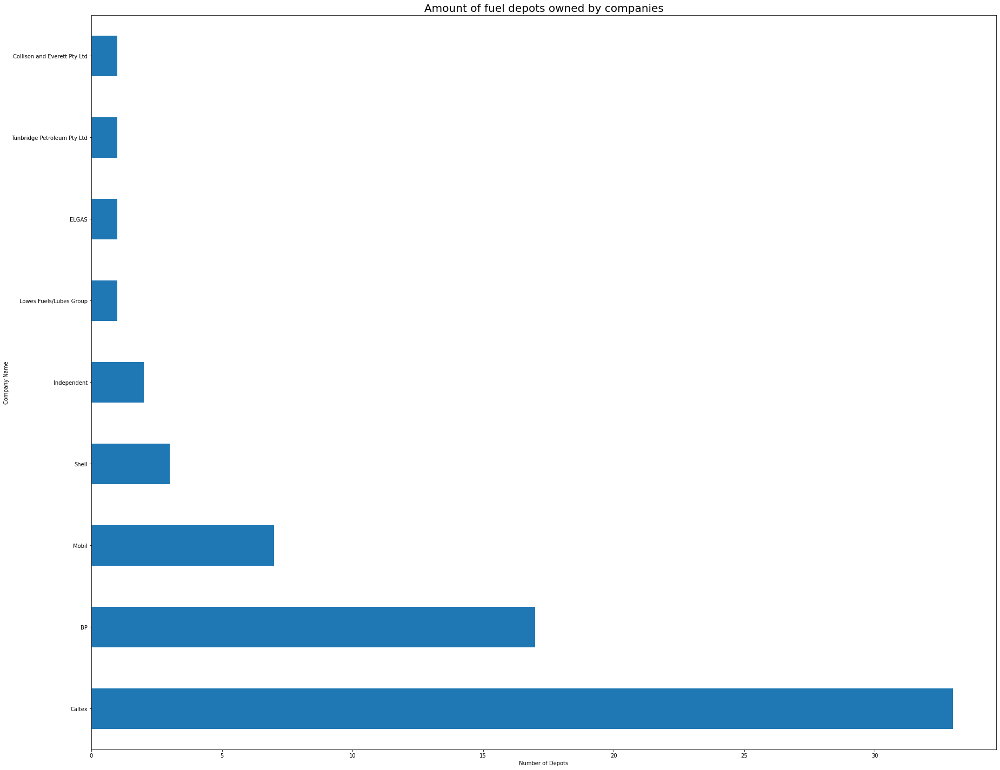

In [18]:
fuel_depot_data = fuel_depots["OWNER"].value_counts()
fuel_depot_data.plot.barh()
plt.title("Amount of fuel depots owned by companies", fontsize=20)
plt.xlabel("Number of Depots", fontsize=10)
plt.ylabel("Company Name", fontsize=10)


In [19]:
reshaped_df["Address_Brand"] = reshaped_df.apply(lambda row: f"{row.Address} {row.Brand}", axis =1)

In [20]:
df_withtime = reshaped_df[(reshaped_df.Price_DL_UpdatedDate > "2021-05-01 00:07:01")
                 & (reshaped_df.Price_DL_UpdatedDate < "2021-05-31 23:59:59")]
price_frame_df = df_withtime[df_withtime.Price_DL>140]
price_frame_df.head()

,Address,Brand,Postcode,Price_DL,Price_DL_UpdatedDate,Price_E10,Price_E10_UpdatedDate,Price_E85,Price_E85_UpdatedDate,Price_LPG,...,Price_P98_UpdatedDate,Price_PDL,Price_PDL_UpdatedDate,Price_U91,Price_U91_UpdatedDate,ServiceStationName,Suburb,Price_nan_UpdatedDate,Price_nan,Address_Brand
198,"131-133 Cobra St (Cnr Fitzroy St), Dubbo NSW 2830",Coles Express,2830.0,143.9,2021-05-01 09:35:45,NaN,NaT,NaN,NaT,NaN,...,NaT,NaN,NaT,NaN,NaT,Coles Express Dubbo,Dubbo,NaT,NaN,"131-133 Cobra St (Cnr Fitzroy St), Dubbo NSW 2..."
918,"2 Myers Street, WILCANNIA NSW 2880",Liberty,2880.0,149.0,2021-05-02 15:06:59,NaN,NaT,NaN,NaT,NaN,...,NaT,NaN,NaT,149.0,2021-05-02 15:06:59,Wilcannia Roadhouse Grahams Motel,WILCANNIA,NaT,NaN,"2 Myers Street, WILCANNIA NSW 2880 Liberty"
989,"300 New England Highway, Rutherford NSW 2320",Caltex Woolworths,2320.0,159.9,2021-05-02 17:49:27,157.9,2021-05-02 17:49:27,NaN,NaT,NaN,...,2021-05-02 17:49:27,NaN,NaT,NaN,NaT,Caltex Woolworths Rutherford,Rutherford,NaT,NaN,"300 New England Highway, Rutherford NSW 2320 C..."
1234,"1355 Princess Hwy (Cnr Oliver Rd), Heathcote N...",Coles Express,2233.0,145.9,2021-05-03 07:15:52,151.9,2021-05-03 07:15:52,NaN,NaT,NaN,...,2021-05-03 07:15:52,NaN,NaT,NaN,NaT,Coles Express Heathcote,Heathcote,NaT,NaN,"1355 Princess Hwy (Cnr Oliver Rd), Heathcote N..."
1419,"Whylandra St & Victoria St, Dubbo NSW 2830",Coles Express,2830.0,143.9,2021-05-03 09:05:45,NaN,NaT,NaN,NaT,NaN,...,NaT,NaN,NaT,NaN,NaT,Coles Express Dubbo,Dubbo,NaT,NaN,"Whylandra St & Victoria St, Dubbo NSW 2830 Col..."


In [21]:
df_withtime = reshaped_df[(reshaped_df.Price_DL_UpdatedDate > "2021-05-01 00:07:01")
                 & (reshaped_df.Price_DL_UpdatedDate < "2021-05-31 23:59:59")]
price_frame_df_low = df_withtime[df_withtime.Price_DL<130]
price_frame_df_low.head()

,Address,Brand,Postcode,Price_DL,Price_DL_UpdatedDate,Price_E10,Price_E10_UpdatedDate,Price_E85,Price_E85_UpdatedDate,Price_LPG,...,Price_P98_UpdatedDate,Price_PDL,Price_PDL_UpdatedDate,Price_U91,Price_U91_UpdatedDate,ServiceStationName,Suburb,Price_nan_UpdatedDate,Price_nan,Address_Brand
17,"6b 1-10 Amy Close, WYONG NSW 2259",Metro Fuel,2259.0,125.9,2021-05-01 04:27:01,122.9,2021-05-01 04:27:01,NaN,NaT,NaN,...,NaT,NaN,NaT,124.9,2021-05-01 04:27:01,Metro North Wyong,WYONG,NaT,NaN,"6b 1-10 Amy Close, WYONG NSW 2259 Metro Fuel"
28,"88 Clovelly Rd, RANDWICK NSW 2031",Independent,2031.0,129.8,2021-05-01 05:12:36,NaN,NaT,NaN,NaT,NaN,...,NaT,NaN,NaT,139.8,2021-05-01 05:12:36,Randwick Petroleum,RANDWICK,NaT,NaN,"88 Clovelly Rd, RANDWICK NSW 2031 Independent"
66,"1540 Windsor Road, Vineyard NSW 2765",Independent,2765.0,128.7,2021-05-01 07:07:20,NaN,NaT,NaN,NaT,NaN,...,NaT,NaN,NaT,NaN,NaT,FREEDOM FUEL VINEYARD,Vineyard,NaT,NaN,"1540 Windsor Road, Vineyard NSW 2765 Independent"
115,"62-68 Clinton Street, GOULBURN NSW 2580",Metro Fuel,2580.0,126.7,2021-05-01 08:16:54,NaN,NaT,NaN,NaT,NaN,...,NaT,126.7,2021-05-01 08:16:54,134.9,2021-05-01 08:16:54,Metro Petroleum Goulburn,GOULBURN,NaT,NaN,"62-68 Clinton Street, GOULBURN NSW 2580 Metro ..."
288,"338 Princes Hwy, BLAKEHURST NSW 2221",Westside,2221.0,127.9,2021-05-01 11:05:14,NaN,NaT,NaN,NaT,NaN,...,NaT,NaN,NaT,131.9,2021-05-01 11:05:14,Westside Petroleum Blakehurst,BLAKEHURST,NaT,NaN,"338 Princes Hwy, BLAKEHURST NSW 2221 Westside"


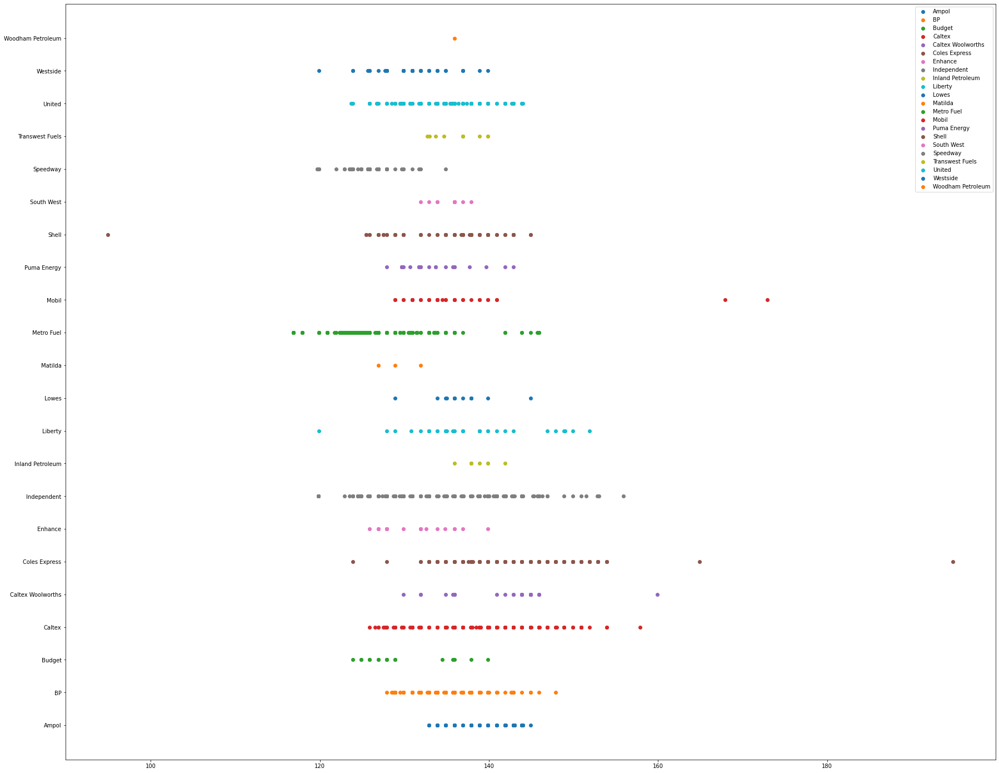

In [22]:
for name, data in df_withtime.groupby("Brand"):
    plt.scatter(data.Price_DL, data.Brand, label = name)
plt.legend()

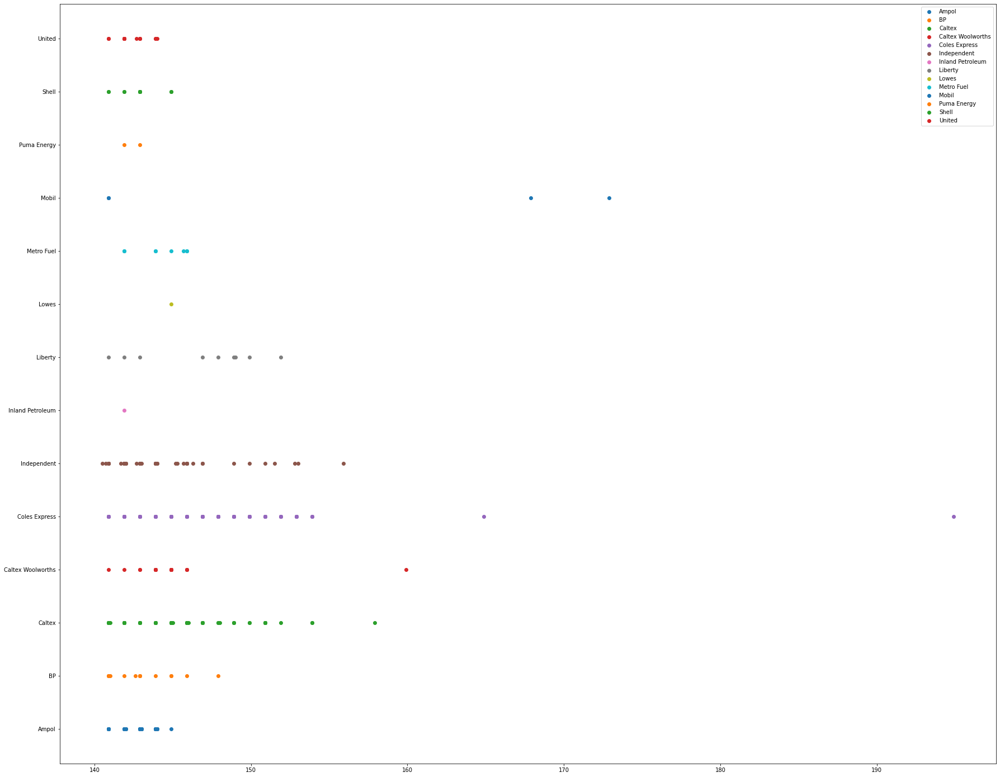

In [23]:
for name, data in price_frame_df.groupby("Brand"):
    plt.scatter(data.Price_DL, data.Brand, label = name)
plt.legend()

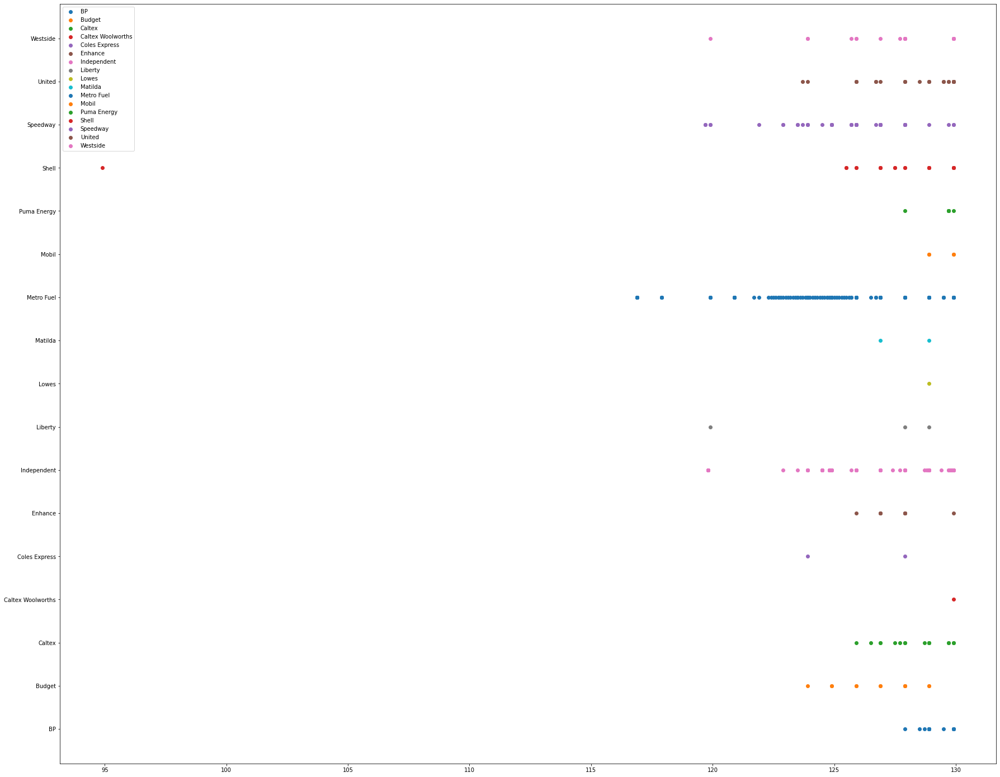

In [24]:
for name, data in price_frame_df_low.groupby("Brand"):
    plt.scatter(data.Price_DL, data.Brand, label = name)
plt.legend()

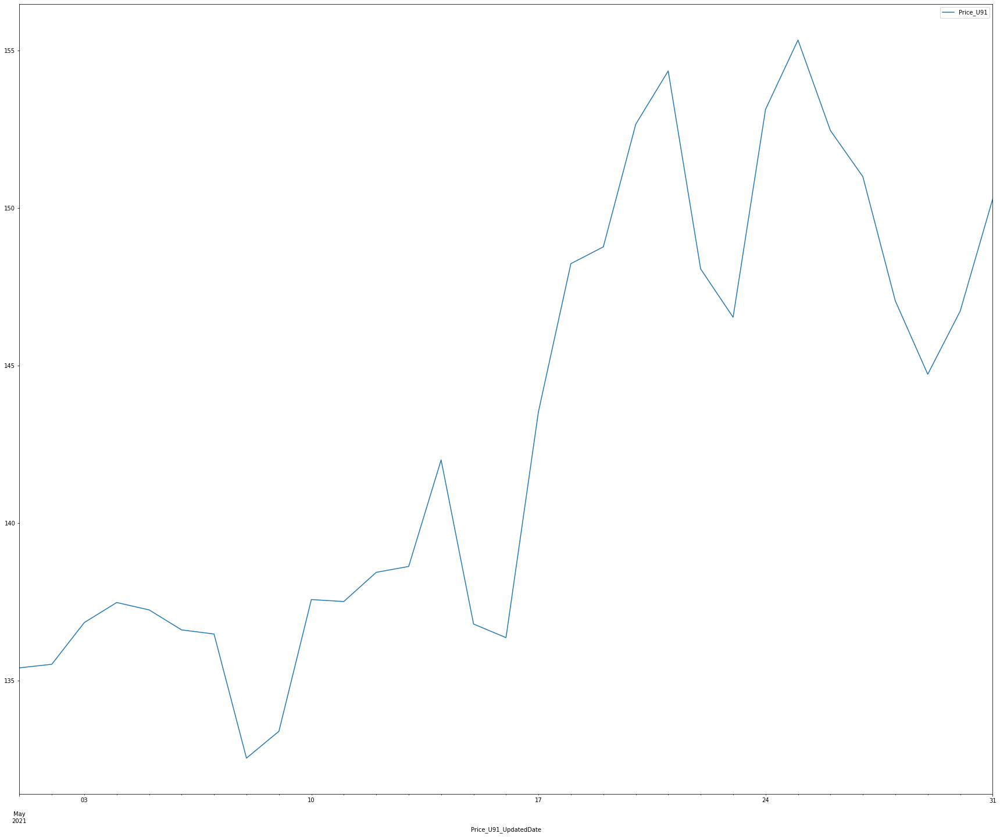

In [25]:
reshaped_df.set_index("Price_U91_UpdatedDate").groupby(pd.Grouper(freq="D")).mean().Price_U91.plot()
plt.legend()

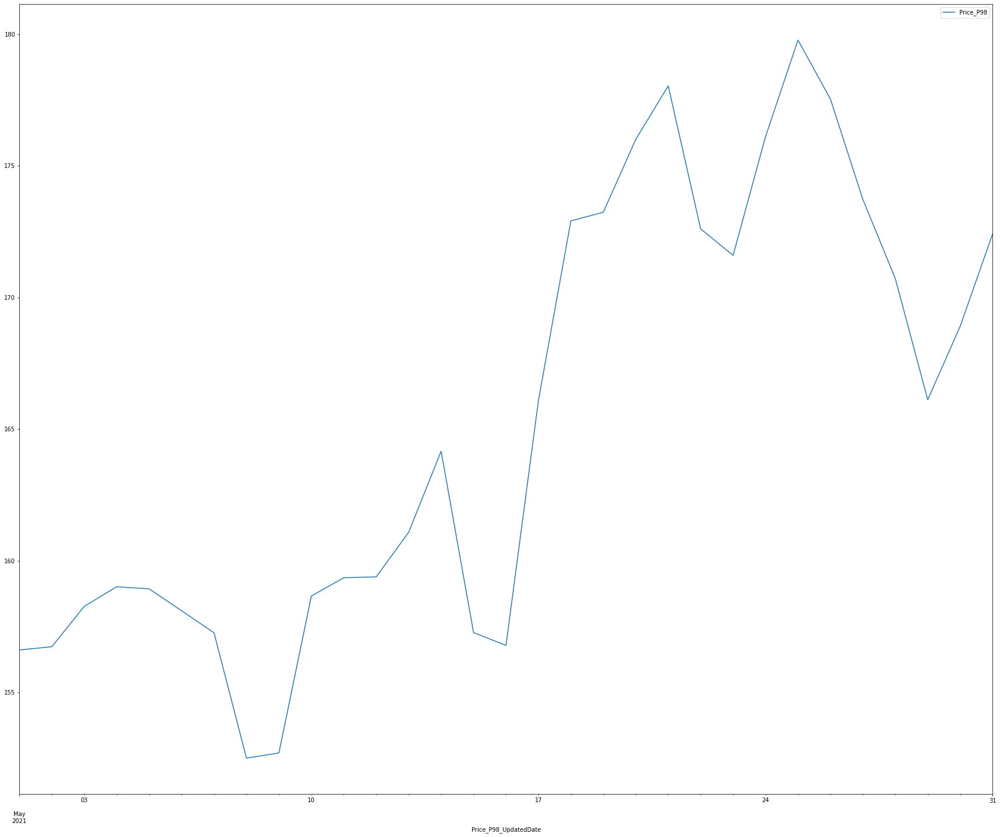

In [26]:
reshaped_df.set_index("Price_P98_UpdatedDate").groupby(pd.Grouper(freq="D")).mean().Price_P98.plot()
plt.legend()

Text(0.5, 1.0, 'NSW Map with Fuel Stations and Depots')

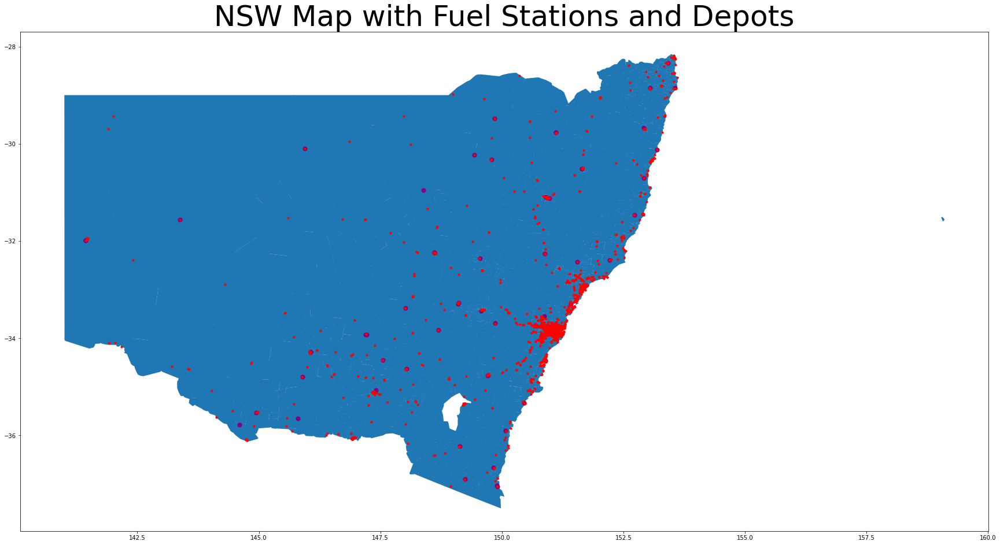

In [27]:
nsw_map = burbs.geometry.convex_hull.plot()
fuel_depots_geo.plot(ax=nsw_map, c="purple", markersize=50)
fuel_station_coordinates_geo.plot(
    ax=nsw_map, c="red", markersize=10, legend=True)

plt.title("NSW Map with Fuel Stations and Depots", fontsize = 50)


In [65]:
fuel_depots.head()

,OBJECTID,FEATURETYPE,DESCRIPTION,CLASS,FID,NAME,OPERATIONALSTATUS,OPERATOR,OWNER,ADDRESS,SUBURB,STATE,SPATIALCONFIDENCE,REVISED,COMMENT,LATITUDE,LONGITUDE
0,1,Fuel Depot,A facility used for the bulk storage of petrol...,Fuel Depot,52,Eden,Operational,Caltex,Caltex,Lot 23 Ben Boyd Drive,Eden,New South Wales,4,20121004,8 lay Down tanks + 1 lay down tank possibly fo...,-37.038479,149.891540
1,2,Fuel Depot,A facility used for the bulk storage of petrol...,Fuel Depot,53,Temora Fuel Distributors,Operational,Temora Fuel Distributors,BP,9 Ironbark Street,Temora,New South Wales,5,20121004,"3 med + 1 med + 1 separate lay down tank, 2 me...",-34.447685,147.552978
2,3,Fuel Depot,A facility used for the bulk storage of petrol...,Fuel Depot,54,Dubbo,Operational,Inland Petroleum,BP,105 Erskine Street,Dubbo,New South Wales,5,20121004,"Station as well, 1 Terminal sized upright + 10...",-32.244324,148.610268
3,4,Fuel Depot,A facility used for the bulk storage of petrol...,Fuel Depot,55,Dubbo,Operational,Lowes Petroleum Service,Mobil,107 Erskine Street,Dubbo,New South Wales,5,20121004,"Station as well, 5 large + 2 small upright tan...",-32.244473,148.611153
4,5,Fuel Depot,A facility used for the bulk storage of petrol...,Fuel Depot,56,Dubbo,Operational,Shell,Shell,109-113 Erskine Street,Dubbo,New South Wales,5,20121004,"Station as well, 1 terminal sized + 1 small up...",-32.244732,148.612396


Text(0.5, 1.0, 'Fuel Depot locations and Fuel Prices')

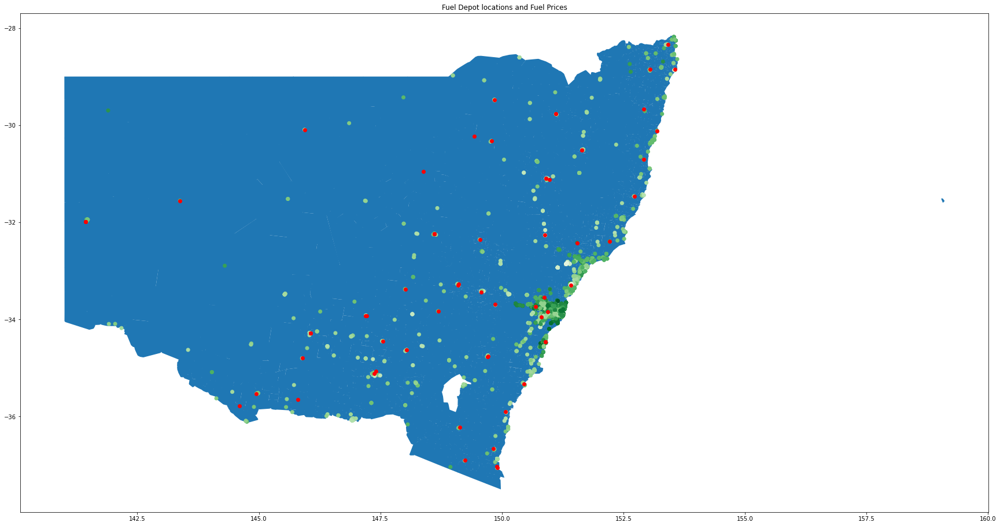

In [68]:
nsw_map = burbs.geometry.convex_hull.plot()
plt.scatter(new_fuel_station_coordinates.longitude, new_fuel_station_coordinates.latitude, c=new_fuel_station_coordinates.Price_U91, cmap='Greens')
plt.scatter(fuel_depots.LONGITUDE, fuel_depots.LATITUDE, c = "red")

plt.title("Fuel Depot locations and Fuel Prices")

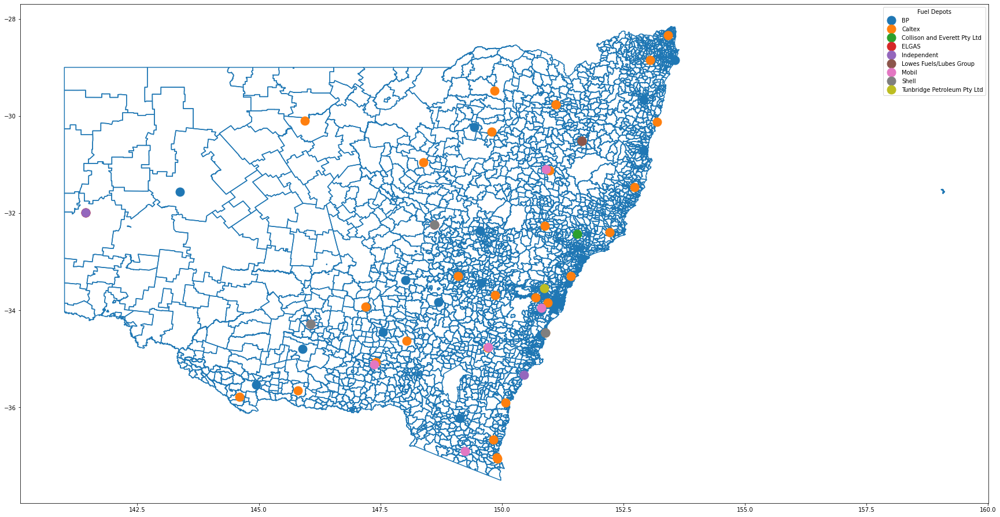

In [118]:
nsw_map = burbs.geometry.boundary.plot()
owners = fuel_depots.groupby("OWNER")
for name, owner in owners:
    plt.plot(owner.LONGITUDE, owner.LATITUDE, marker = 'o', linestyle='', markersize=15, label=name)
plt.legend(title='Fuel Depots')

In [93]:
def new_legend_color(n):
    if n < 119:
        return "Group 0 - 119"
    elif 120 < n < 129:
        return "Group 120-129"
    elif 130 < n < 139:
        return "Group 130-139"
    elif 140 < n <149:
        return "Group 140-149"
    elif 150 < n <159:
        return "Group 150-159"
    elif 160 < n <200:
        return "Group 160-200"
    elif n == str:
        return n

new_fuel_station_coordinates["Price_Group_New"] = new_fuel_station_coordinates.Price_U91.apply(new_legend_color)
new_fuel_station_coordinates.sample(10)

,Unnamed: 0,Address,Brand,Postcode,Price_DL,Price_DL_UpdatedDate,Price_E10,Price_E10_UpdatedDate,Price_E85,Price_E85_UpdatedDate,...,ServiceStationName,Suburb,latitude,longitude,Price Group,Price_Group,test,t,Try,Price_Group_New
3919,5587,"68 MAIN ST, WEST WYALONG NSW 2671",BP,2671.0,136.9,05/09/2021 8:52,NaN,NaN,NaN,NaN,...,BP WEST WYALONG,WEST WYALONG,-33.922466,147.203122,Group 130-139,Group 130-139,NaN,NaN,Group 130-139,Group 130-139
5912,8284,"1/158 Auburn Rd, Birrong NSW 2143",Speedway,2143.0,123.9,05/12/2021 20:46,124.9,05/12/2021 20:46,NaN,NaN,...,Speedway Birrong,Birrong,-33.890654,151.022315,Group 120-129,Group 120-129,NaN,NaN,Group 120-129,Group 120-129
13545,18698,"227 Military Rd, Cremorne NSW 2090",Coles Express,2090.0,146.9,05/28/2021 14:00,NaN,NaN,NaN,NaN,...,Coles Express Cremorne,Cremorne,-33.830783,151.225196,None,None,NaN,NaN,None,None
4495,6375,"3 Thomas Rose Drive, Rosemeadow NSW 2560",Caltex Woolworths,2560.0,NaN,NaN,134.9,05/10/2021 14:36,NaN,NaN,...,Caltex Woolworths Rosemeadow,Rosemeadow,-34.100445,150.799598,Group 130-139,Group 130-139,NaN,NaN,Group 130-139,Group 130-139
12011,16651,"262-272 Victoria Road, Rydalmere NSW 2116",United,2116.0,NaN,NaN,156.9,05/26/2021 7:28,NaN,NaN,...,United Petroleum Rydalmere,Rydalmere,-33.811552,151.036506,Group 150-159,Group 150-159,NaN,NaN,Group 150-159,Group 150-159
479,689,"28 Princes Highway, Arncliffe NSW 2205",7-Eleven,2205.0,NaN,NaN,134.4,05/02/2021 7:37,NaN,NaN,...,7-Eleven Arncliffe,Arncliffe,-33.936689,151.149669,Group 130-139,Group 130-139,NaN,NaN,Group 130-139,Group 130-139
10489,14604,"289 Cessnock Road, Abermain NSW 2326",Metro Fuel,2326.0,NaN,NaN,132.9,05/23/2021 17:53,NaN,NaN,...,Metro Fuel Abermain,Abermain,-32.812635,151.442885,None,None,NaN,NaN,None,None
1142,1675,"Lot 6 Luxford Road, Mount Druitt NSW 2770",7-Eleven,2770.0,NaN,NaN,131.5,05/03/2021 15:12,NaN,NaN,...,7-Eleven Mount Druitt,Mount Druitt,-33.764482,150.819349,Group 130-139,Group 130-139,NaN,NaN,Group 130-139,Group 130-139
2742,3918,"102 Maloney St, Eastlakes NSW 2018",Budget,2018.0,NaN,NaN,132.9,05/06/2021 7:56,NaN,NaN,...,Budget Petrol Eastlakes,Eastlakes,-33.923324,151.206963,Group 130-139,Group 130-139,NaN,NaN,Group 130-139,Group 130-139
11154,15459,"472 CABRAMATTA RD, MOUNT PRITCHARD NSW 2170",Metro Fuel,2170.0,NaN,NaN,137.9,05/24/2021 19:15,NaN,NaN,...,Metro Mt Pritchard,MOUNT PRITCHARD,-33.897584,150.914091,None,None,NaN,NaN,None,None


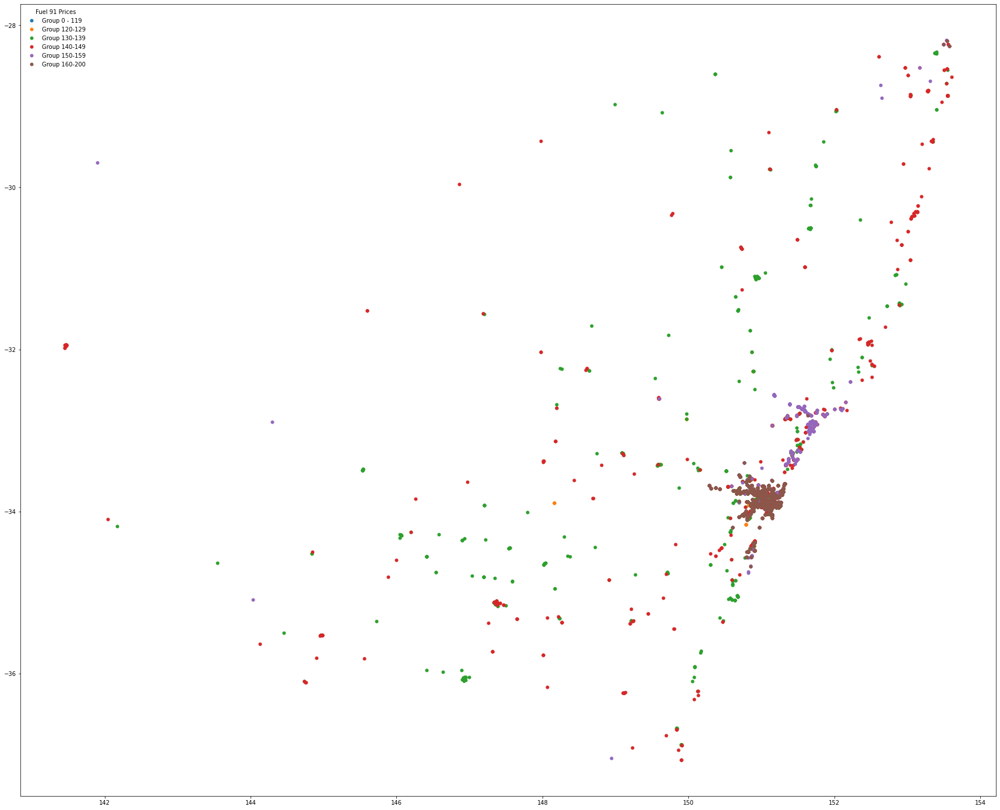

In [113]:
groups = price_U91.groupby("Price_Group_New")
for name, group in groups:
    plt.plot(group.longitude, group.latitude, marker = "o", linestyle='', markersize = 5, label=name)
plt.legend(scatterpoints=1, frameon=False, title='Fuel 91 Prices')

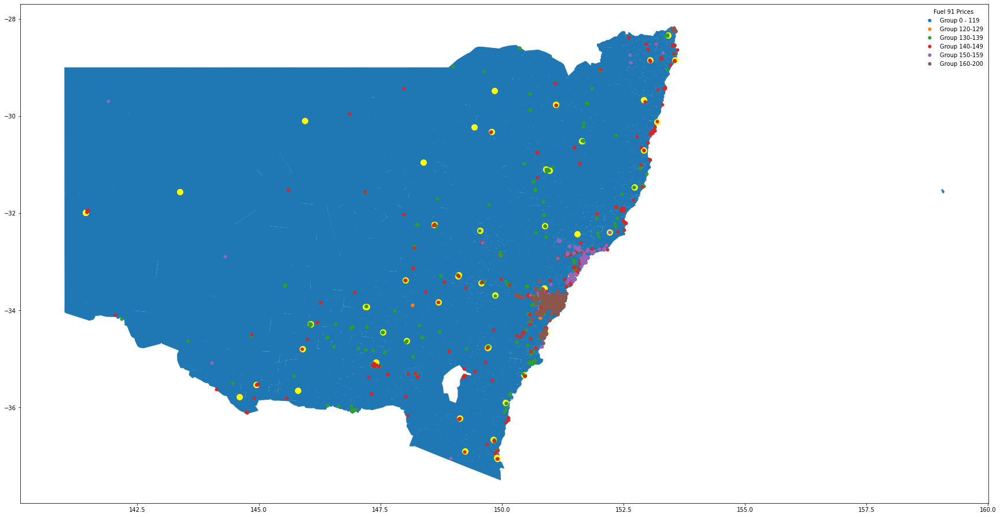

In [121]:
nsw_map = burbs.geometry.convex_hull.plot()
groups = price_U91.groupby("Price_Group_New")
for name, group in groups:
    plt.plot(group.longitude, group.latitude, marker = "o", linestyle='', markersize = 5, label=name)
plt.scatter(fuel_depots.LONGITUDE, fuel_depots.LATITUDE, c = "yellow", s=100)
plt.legend(scatterpoints=1, frameon=False, title='Fuel 91 Prices')

In [29]:
map_in_nsw = folium.Map(location=[-33.8688, 151.2093],  zoom_start=10)
map_in_nsw

In [131]:
fuel_depots.head()

,OBJECTID,FEATURETYPE,DESCRIPTION,CLASS,FID,NAME,OPERATIONALSTATUS,OPERATOR,OWNER,ADDRESS,SUBURB,STATE,SPATIALCONFIDENCE,REVISED,COMMENT,LATITUDE,LONGITUDE
0,1,Fuel Depot,A facility used for the bulk storage of petrol...,Fuel Depot,52,Eden,Operational,Caltex,Caltex,Lot 23 Ben Boyd Drive,Eden,New South Wales,4,20121004,8 lay Down tanks + 1 lay down tank possibly fo...,-37.038479,149.891540
1,2,Fuel Depot,A facility used for the bulk storage of petrol...,Fuel Depot,53,Temora Fuel Distributors,Operational,Temora Fuel Distributors,BP,9 Ironbark Street,Temora,New South Wales,5,20121004,"3 med + 1 med + 1 separate lay down tank, 2 me...",-34.447685,147.552978
2,3,Fuel Depot,A facility used for the bulk storage of petrol...,Fuel Depot,54,Dubbo,Operational,Inland Petroleum,BP,105 Erskine Street,Dubbo,New South Wales,5,20121004,"Station as well, 1 Terminal sized upright + 10...",-32.244324,148.610268
3,4,Fuel Depot,A facility used for the bulk storage of petrol...,Fuel Depot,55,Dubbo,Operational,Lowes Petroleum Service,Mobil,107 Erskine Street,Dubbo,New South Wales,5,20121004,"Station as well, 5 large + 2 small upright tan...",-32.244473,148.611153
4,5,Fuel Depot,A facility used for the bulk storage of petrol...,Fuel Depot,56,Dubbo,Operational,Shell,Shell,109-113 Erskine Street,Dubbo,New South Wales,5,20121004,"Station as well, 1 terminal sized + 1 small up...",-32.244732,148.612396


In [39]:
fuel_station_coordinates.head()

,Number,station,location,latitude,longitude,owner,geometry
0,0,"702-704 Warringah Road, Forestville NSW 2087","Warringah Road, Forestville, Sydney, Northern ...",-33.760921,151.216115,Metro Fuel,POINT (151.2161153 -33.7609212)
1,2,"125 Brunker Rd, Adamstown NSW 2289","Brunker Road, Adamstown, Newcastle, Newcastle ...",-32.943960,151.722761,Westside,POINT (151.7227611 -32.9439598)
2,3,"323 River Street, BALLINA NSW 2478","323, River Street, Ballina CBD, Ballina, Balli...",-28.866000,153.550280,Metro Fuel,POINT (153.5502802 -28.86600025)
3,4,"656 Warringah Road, FORESTVILLE NSW 2087","Warringah Road, Forestville, Sydney, Northern ...",-33.760921,151.216115,Metro Fuel,POINT (151.2161153 -33.7609212)
4,5,"198 Hill End Road, Doonside NSW 2767","Hill End Road, Doonside, Sydney, Blacktown Cit...",-33.761139,150.869841,Metro Fuel,POINT (150.8698407 -33.7611391)


In [34]:
map_in_nsw = folium.Map(location=[-33.8688, 151.2093],  zoom_start=10)
for (index, row) in fuel_depots.iterrows():
    folium.Marker(location=[row.loc["LATITUDE"], row.loc["LONGITUDE"]],
                  popup=row.loc["OWNER"], tooltip="Fuel Depots").add_to(map_in_nsw)
    folium.CircleMarker(location=[row.loc["LATITUDE"], row.loc["LONGITUDE"]], radius=50).add_to(map_in_nsw)
for (index, row) in fuel_station_coordinates.iterrows():
    folium.Marker(location=[row.loc["latitude"], row.loc["longitude"]],
                  popup=row.loc["owner"], tooltip="Fuel stations").add_to(map_in_nsw)
map_in_nsw


In [22]:
def get_addr_and_type(row):
    fueltypes = ['Price_DL', 'Price_E10',  'Price_E85', 'Price_LPG',
                 'Price_P95', 'Price_P98',
                 'Price_PDL',
                 'Price_U91', ]
    for ft in fueltypes:
        if row[ft]:
            return row[ft]


df_withtime["address_fueltype"] = df_withtime.apply(get_addr_and_type, axis=1)


c:\Users\Karson\1161\data_project_2021\data-project-env\lib\site-packages\pandas\core\frame.py:3607: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._set_item(key, value)


In [23]:
def get_time_and_append(row):
    fuelupdatedates = ['Price_DL_UpdatedDate', 'Price_E10_UpdatedDate', 'Price_E85_UpdatedDate',  'Price_LPG_UpdatedDate','Price_P95_UpdatedDate', 'Price_P98_UpdatedDate',  'Price_PDL_UpdatedDate', 'Price_U91_UpdatedDate', 'Price_nan_UpdatedDate']
    for ft in fuelupdatedates:
        if row[ft]:
            return row[ft]


df_withtime["fueltype_update"] = df_withtime.apply(get_time_and_append, axis=1)
df_withtime.sample(5)


,Address,Brand,Postcode,Price_DL,Price_DL_UpdatedDate,Price_E10,Price_E10_UpdatedDate,Price_E85,Price_E85_UpdatedDate,Price_LPG,...,Price_PDL_UpdatedDate,Price_U91,Price_U91_UpdatedDate,ServiceStationName,Suburb,Price_nan_UpdatedDate,Price_nan,Address_Brand,address_fueltype,fueltype_update
9602,"74 Roberts Road, Greenacre NSW 2190",Coles Express,2190.0,137.9,2021-05-14 18:30:54,NaN,NaT,NaN,NaT,NaN,...,NaT,NaN,NaT,Coles Express Greenacre,Greenacre,NaT,NaN,"74 Roberts Road, Greenacre NSW 2190 Coles Express",137.9,2021-05-14 18:30:54
8876,"1 Hanrahan Place (Cnr Leeds Pde), Orange NSW 2800",Caltex Woolworths,2800.0,131.9,2021-05-13 17:52:52,NaN,NaT,NaN,NaT,NaN,...,2021-05-13 17:52:52,NaN,NaT,Caltex Woolworths Orange North,Orange,NaT,NaN,"1 Hanrahan Place (Cnr Leeds Pde), Orange NSW 2...",131.9,2021-05-13 17:52:52
10085,"68 Bathurst Road, ORANGE NSW 2800",Metro Fuel,2800.0,123.0,2021-05-16 07:26:47,NaN,NaT,NaN,NaT,NaN,...,NaT,NaN,NaT,Metro Orange( Bathurst Road),ORANGE,NaT,NaN,"68 Bathurst Road, ORANGE NSW 2800 Metro Fuel",123.0,2021-05-16 07:26:47
9430,"Mid West Highway, West Wyalong NSW 2671",Caltex,2671.0,141.9,2021-05-14 18:01:50,NaN,NaT,NaN,NaT,NaN,...,2021-05-14 18:01:50,NaN,NaT,Caltex West Wyalong,West Wyalong,NaT,NaN,"Mid West Highway, West Wyalong NSW 2671 Caltex",141.9,2021-05-14 18:01:50
9591,"38-46 Victoria Rd, Drummoyne NSW 2047",Coles Express,2047.0,137.9,2021-05-14 18:30:54,NaN,NaT,NaN,NaT,NaN,...,NaT,NaN,NaT,Coles Express Drummoyne,Drummoyne,NaT,NaN,"38-46 Victoria Rd, Drummoyne NSW 2047 Coles Ex...",137.9,2021-05-14 18:30:54


In [ ]:
reshaped_df["Suburb"]


1           Forestville
2        CAMBRIDGE PARK
3             Adamstown
4               BALLINA
5           FORESTVILLE
              ...      
21150      FAIRY MEADOW
21151       WILLIAMTOWN
21152         Balgownie
21153           FIGTREE
21154     FAULCONBRIDGE
Name: Suburb, Length: 21154, dtype: object

In [ ]:
reshaped_df.Suburb = reshaped_df.Suburb.apply(lambda x: x.upper())

In [ ]:
reshaped_df.Suburb

1           FORESTVILLE
2        CAMBRIDGE PARK
3             ADAMSTOWN
4               BALLINA
5           FORESTVILLE
              ...      
21150      FAIRY MEADOW
21151       WILLIAMTOWN
21152         BALGOWNIE
21153           FIGTREE
21154     FAULCONBRIDGE
Name: Suburb, Length: 21154, dtype: object

In [133]:
# for name, data in df.groupby(reshaped_df.Suburb):
#     plt.scatter(data.plot(), data.Suburb, label = name)
# plt.legend()

In [ ]:
reshaped_df[reshaped_df.Suburb == "CESSNOCK"]

,Address,Brand,Postcode,Price_DL,Price_DL_UpdatedDate,Price_E10,Price_E10_UpdatedDate,Price_E85,Price_E85_UpdatedDate,Price_LPG,...,Price_P98_UpdatedDate,Price_PDL,Price_PDL_UpdatedDate,Price_U91,Price_U91_UpdatedDate,ServiceStationName,Suburb,Price_nan_UpdatedDate,Price_nan,add_own
23,"102 Wollombi Rd, CESSNOCK NSW 2325",Metro Fuel,2325.0,NaN,NaT,122.9,2021-05-01 05:01:18,NaN,NaT,NaN,...,NaT,NaN,NaT,124.9,2021-05-01 05:01:18,Metro Cessnock,CESSNOCK,NaT,NaN,"102 Wollombi Rd, CESSNOCK NSW 2325 Metro Fuel"
103,"210-214 Wollombi Road, Cessnock NSW 2325",7-Eleven,2325.0,NaN,NaT,125.5,2021-05-01 08:01:25,NaN,NaT,NaN,...,2021-05-01 08:01:25,NaN,NaT,127.5,2021-05-01 08:01:25,7-Eleven Cessnock,CESSNOCK,NaT,NaN,"210-214 Wollombi Road, Cessnock NSW 2325 7-Eleven"
496,"220 Wollombi Road, Cessnock NSW 2325",Caltex Woolworths,2325.0,NaN,NaT,125.5,2021-05-01 16:21:16,NaN,NaT,NaN,...,2021-05-01 16:21:16,NaN,NaT,NaN,NaT,Caltex Woolworths Cessnock,CESSNOCK,NaT,NaN,"220 Wollombi Road, Cessnock NSW 2325 Caltex Wo..."
515,"210-214 Wollombi Road, Cessnock NSW 2325",7-Eleven,2325.0,NaN,NaT,125.9,2021-05-01 16:56:44,NaN,NaT,NaN,...,2021-05-01 16:56:44,NaN,NaT,127.9,2021-05-01 16:56:44,7-Eleven Cessnock,CESSNOCK,NaT,NaN,"210-214 Wollombi Road, Cessnock NSW 2325 7-Eleven"
542,"102 Wollombi Rd, CESSNOCK NSW 2325",Metro Fuel,2325.0,NaN,NaT,119.9,2021-05-01 17:59:11,NaN,NaT,NaN,...,NaT,NaN,NaT,114.9,2021-05-01 17:59:11,Metro Cessnock,CESSNOCK,NaT,NaN,"102 Wollombi Rd, CESSNOCK NSW 2325 Metro Fuel"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20311,"183 Vincent St, Cessnock NSW 2325",Coles Express,2325.0,139.9,2021-05-31 07:30:48,NaN,NaT,NaN,NaT,NaN,...,NaT,NaN,NaT,NaN,NaT,Coles Express Cessnock,CESSNOCK,NaT,NaN,"183 Vincent St, Cessnock NSW 2325 Coles Express"
20322,"210-214 Wollombi Road, Cessnock NSW 2325",7-Eleven,2325.0,NaN,NaT,126.9,2021-05-31 07:40:33,NaN,NaT,NaN,...,2021-05-31 07:40:33,NaN,NaT,128.9,2021-05-31 07:40:33,7-Eleven Cessnock,CESSNOCK,NaT,NaN,"210-214 Wollombi Road, Cessnock NSW 2325 7-Eleven"
20737,"220 Wollombi Road, Cessnock NSW 2325",Caltex Woolworths,2325.0,NaN,NaT,126.9,2021-05-31 13:21:38,NaN,NaT,NaN,...,2021-05-31 13:21:38,NaN,NaT,NaN,NaT,Caltex Woolworths Cessnock,CESSNOCK,NaT,NaN,"220 Wollombi Road, Cessnock NSW 2325 Caltex Wo..."
21013,"102 Wollombi Rd, CESSNOCK NSW 2325",Metro Fuel,2325.0,NaN,NaT,120.7,2021-05-31 18:06:55,NaN,NaT,NaN,...,NaT,NaN,NaT,122.7,2021-05-31 18:06:55,Metro Cessnock,CESSNOCK,NaT,NaN,"102 Wollombi Rd, CESSNOCK NSW 2325 Metro Fuel"
